### 유통 카테고리별 당일(매출지수 * 매출비중)

In [ ]:
업태별로 보면, 짐작했던 것처럼 언택트 영향으로 인해 온라인 쇼핑몰이 높은 성장세를 나타냈다.
반면에 사람과 접촉할 기회가 많은 대형마트나 백화점 같은 집합 시설은 기피되는 양상을 보였다.
전년 동기 대비, 판매액이 증가한 곳은 온라인 쇼핑몰(28.3%), 편의점(9.2%), 동네 슈퍼마켓(3.4%) 순서였다.
면세점(36.7%), 백화점(21.1%), 단일 품목을 취급하는 전문소매점(8.6%), 대형마트(4.0%)는 순서대로 판매액이 감소했다.

*통계 출처: <코로나19의 세계적 유행에 따른 산업별 영향 분석>, 하나금융경영연구소, 2020년 4월

In [2]:
df = pd.read_excel('distribution.xlsx')

In [3]:
import xlrd
import hangul_font
import matplotlib.pyplot as plt
%matplotlib inline

Hangul font is set!


In [4]:
df = pd.read_excel('distribution.xlsx',
                   sheet_name = '종합테이블(TB_DD_STR_PURCH_CLS)',
                   header = 0,
                   dtype = {'OPER_DT': str,
                            'PVN':str,
                            'BOR':str,
                            'ADMD':str,
                            'AMT_IND':float,
                            'LCLS_10_P':float,
                            'LCLS_20_P':float,
                            'LCLS_30_P':float,
                            'LCLS_40_P':float,
                            'LCLS_50_P':float,
                            'LCLS_60_P':float,
                            'LCLS_70_P':float,
                            'LCLS_80_P':float},
                   na_values='NaN',
                   nrows=14461)

In [5]:
df.tail(2)

,OPER_DT,PVN,BOR,ADMD,AMT_IND,LCLS_10_P,LCLS_20_P,LCLS_30_P,LCLS_40_P,LCLS_50_P,LCLS_60_P,LCLS_70_P,LCLS_80_P
14458,20200531,서울특별시,중구,황학동,1.134190,0.264708,0.257387,0.367001,0.029140,0.070770,0.00106,0.003646,0.006287
14459,20200531,서울특별시,중구,회현동,0.773963,0.316750,0.160035,0.410281,0.031188,0.071026,0.00000,0.009057,0.001663


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14460 entries, 0 to 14459
Data columns (total 13 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   OPER_DT    14460 non-null  object 
 1   PVN        14460 non-null  object 
 2   BOR        14460 non-null  object 
 3   ADMD       14460 non-null  object 
 4   AMT_IND    14460 non-null  float64
 5   LCLS_10_P  14460 non-null  float64
 6   LCLS_20_P  14460 non-null  float64
 7   LCLS_30_P  14460 non-null  float64
 8   LCLS_40_P  14460 non-null  float64
 9   LCLS_50_P  14460 non-null  float64
 10  LCLS_60_P  14460 non-null  float64
 11  LCLS_70_P  14460 non-null  float64
 12  LCLS_80_P  14460 non-null  float64
dtypes: float64(9), object(4)
memory usage: 1.4+ MB


In [7]:
# 매출 기준일과 기준동은 2019.04.11, 서울 중구 신당5동임
df.loc[(df['OPER_DT'] == '20190411') & (df['ADMD'] == '신당5동')]

,OPER_DT,PVN,BOR,ADMD,AMT_IND,LCLS_10_P,LCLS_20_P,LCLS_30_P,LCLS_40_P,LCLS_50_P,LCLS_60_P,LCLS_70_P,LCLS_80_P
4190,20190411,서울특별시,중구,신당5동,1.0,0.277475,0.257129,0.341531,0.051694,0.052843,0.0054,0.002258,0.01167


#### 1. 년도별로 먼저 나눠주기 

In [8]:
df_19 = df[0:7200]
df_20 = df[7200:]

#### 2. 구별로 나눠주기

In [9]:
df_19_seo_j = df_19[(df_19["PVN"] == '서울특별시') & (df_19["BOR"] == '중구')]
df_19_seo_n = df_19[(df_19["PVN"] == '서울특별시') & (df_19["BOR"] == '노원구')]
df_19_dae_j = df_19[(df_19["PVN"] == '대구광역시') & (df_19["BOR"] == '중구')]
df_19_dae_s = df_19[(df_19["PVN"] == '대구광역시') & (df_19["BOR"] == '수성구')]

In [10]:
df_20_seo_j = df_20[(df_20["PVN"] == '서울특별시') & (df_20["BOR"] == '중구')]
df_20_seo_n = df_20[(df_20["PVN"] == '서울특별시') & (df_20["BOR"] == '노원구')]
df_20_dae_j = df_20[(df_20["PVN"] == '대구광역시') & (df_20["BOR"] == '중구')]
df_20_dae_s = df_20[(df_20["PVN"] == '대구광역시') & (df_20["BOR"] == '수성구')]

In [11]:
# 카테고리별 비율에 당일 매출지수 가중치를 곱해준다
# 
categories_kor = ["식사", '간식', '마실거리', '홈/리빙', '헬스/뷰티', '취미/여가활동', '사회활동', '임신/육아']
categories = ['LCLS_10_P','LCLS_20_P','LCLS_30_P','LCLS_40_P','LCLS_50_P','LCLS_60_P', 'LCLS_70_P','LCLS_80_P']

In [19]:
df_19_seo_j[categories]

,LCLS_10_P,LCLS_20_P,LCLS_30_P,LCLS_40_P,LCLS_50_P,LCLS_60_P,LCLS_70_P,LCLS_80_P
45,0.363447,0.213401,0.317891,0.025101,0.058217,0.002061,0.015406,0.004475
46,0.305121,0.218340,0.379203,0.023285,0.056544,0.006931,0.009617,0.000959
47,0.375368,0.171392,0.356872,0.040101,0.041523,0.000644,0.013135,0.000966
48,0.346485,0.177341,0.299164,0.021181,0.069543,0.067369,0.014005,0.004912
49,0.287643,0.185728,0.383557,0.041739,0.081483,0.004215,0.010749,0.004884
...,...,...,...,...,...,...,...,...
7195,0.303983,0.221554,0.400640,0.023648,0.041415,0.000000,0.007839,0.000920
7196,0.300005,0.214617,0.391840,0.041375,0.031329,0.012856,0.003418,0.004559
7197,0.306059,0.199257,0.384865,0.033652,0.057027,0.005471,0.008752,0.004917
7198,0.284708,0.212218,0.390125,0.032516,0.052842,0.010703,0.007287,0.009601


In [14]:
# 그래프 설명
#     - 지역마다 카테고리별 유통지수 그래프
#     - x축 매출지수는 행정동 별로 나뉜 당일 매출지수를 소속된 구역별로 모두 합쳐줬다
#     - 동시에 카테고리별 유통비중은 평균수치를 구해서 매출지수와 곱해서 유통지수를 구했다
#     - y축은 2020년 2월 1일 토요일로 시작해 5월 29일 끝난다
#     - 같은 그래프에 표시된 2019년 데이터는 2월2일 데이터 부터 시작해 5월 31일 끝난다
#     - 비록 날짜가 하루 차이나게 되지만 (2020년 2월은 윤달이기 때문에 3월부터는 이틀 차이)\
#       y축 따라 년도끼리 요일을 일치 시켜줬다 (유통량 패턴이 요일별로 바뀌는 경향이 더 크다)
regions = ['seo_n', 'seo_j', 'dae_j', 'dae_s']
df_19s = [df_19_seo_j, df_19_seo_n, df_19_dae_j, df_19_dae_s]
df_20s = [df_20_seo_j, df_20_seo_n, df_20_dae_j, df_20_dae_s]

def graph_category_sales_index(regions, df_19s, df_20s, categories):
    for category in categories:
        for region, df_19, df_20 in zip(regions, df_19s, df_20s):
            # setting region and category for graph
            aggregation_functions = {'AMT_IND': 'sum'}
            df_19_sum_amt = df_19.groupby(df_19['OPER_DT'], as_index=False).aggregate(aggregation_functions)

            aggregation_function = {category: 'mean'}
            LCLS_19_P = df_19.groupby(df_19['OPER_DT'], as_index=False).aggregate(aggregation_function)

            LCLS_19 = pd.merge(left=df_19_sum_amt, right=LCLS_19_P, on="OPER_DT")
            LCLS_19['y'] = LCLS_19.AMT_IND * LCLS_19[category]

            aggregation_functions = {'AMT_IND': 'sum'}
            df_20_sum_amt = df_20.groupby(df_20['OPER_DT'], as_index=False).aggregate(aggregation_functions)

            aggregation_function = {category: 'mean'}
            LCLS_20_P = df_20.groupby(df_20['OPER_DT'], as_index=False).aggregate(aggregation_function)

            LCLS_20 = pd.merge(left=df_20_sum_amt, right=LCLS_20_P, on="OPER_DT")
            LCLS_20['y'] = LCLS_20.AMT_IND * LCLS_20[category]

        # graph
            x19 = LCLS_19.OPER_DT
            y19 = LCLS_19.y[1:]
            x20 = LCLS_20[:119].OPER_DT
            y20 = LCLS_20.y[:119]

            # LCLS_20.index[:119]
            # LCLS_19.index[1:]

            plt.figure(figsize=(18,8))
            plt.plot(x20, y19, label='2019')
            plt.plot(x20, y20, label='2020')

            for x in range(2, len(x20), 7):
                plt.axvline(x, color='b', linestyle='--', linewidth=0.9)
            for x in range(7, len(x20), 7):
                plt.axvline(x, color='r', linestyle='--', linewidth=0.9)    

            plt.grid(b=True, axis='y')
            plt.legend()
            plt.xlabel('date (*20200229 omitted; b:wd, r:we)', fontsize=20)
            plt.ylabel(category + ' sales index', fontsize=20)
            plt.xticks([0, 29, 60, 90, 118], rotation=90)
            plt.minorticks_on()
            plt.title(region + ': 19.2.2~5.31 & 20.2.1~5.30; start=saturday', fontsize=30)
            plt.show()


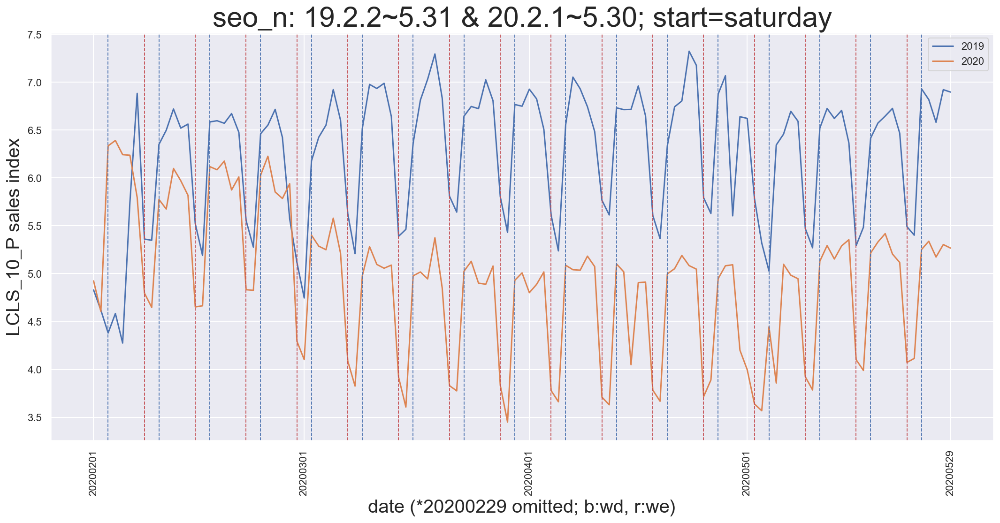

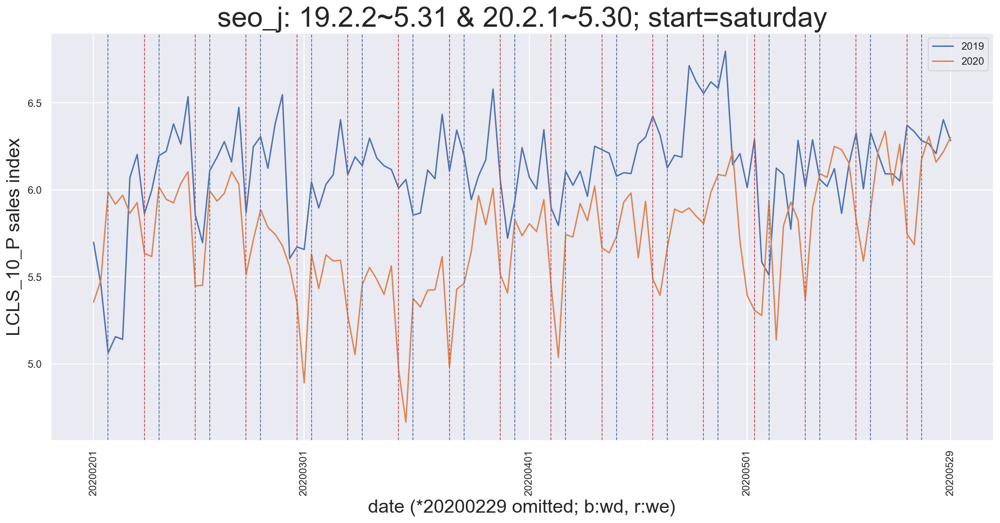

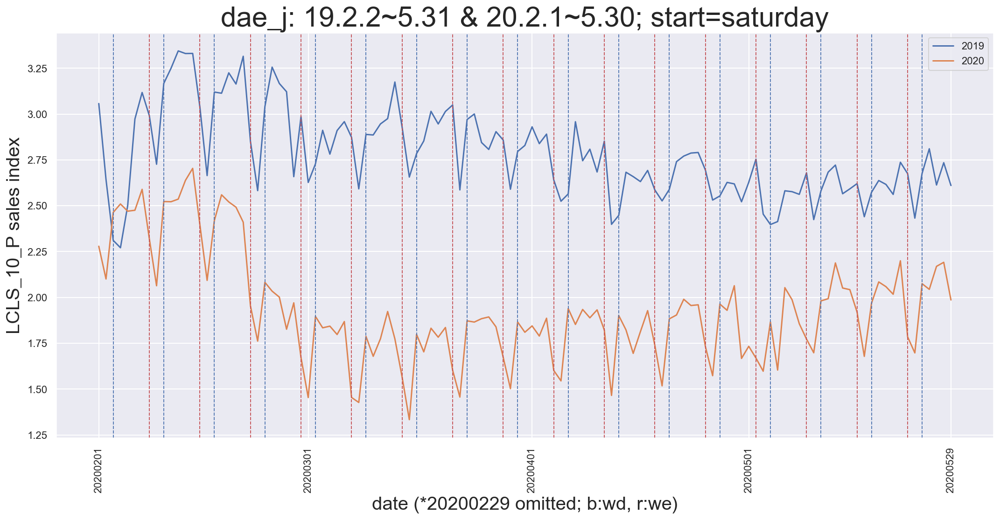

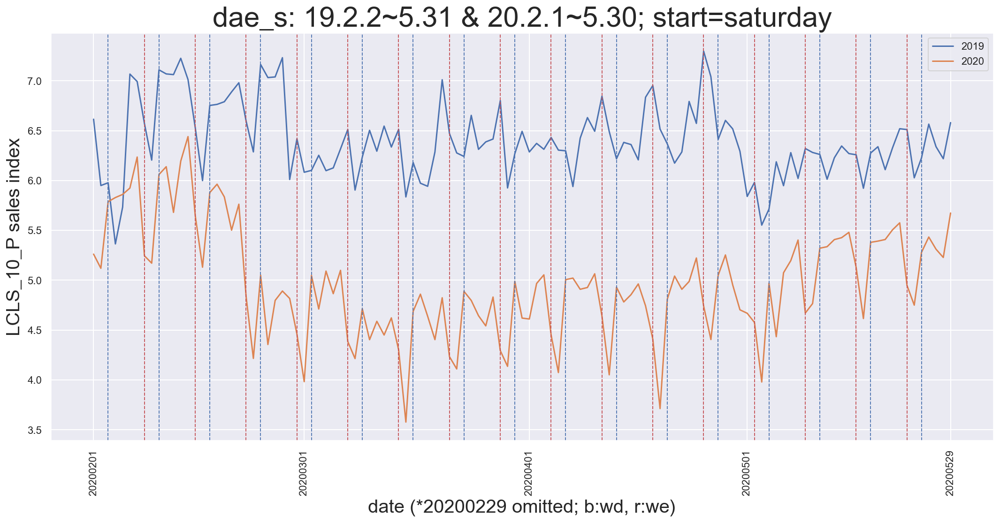

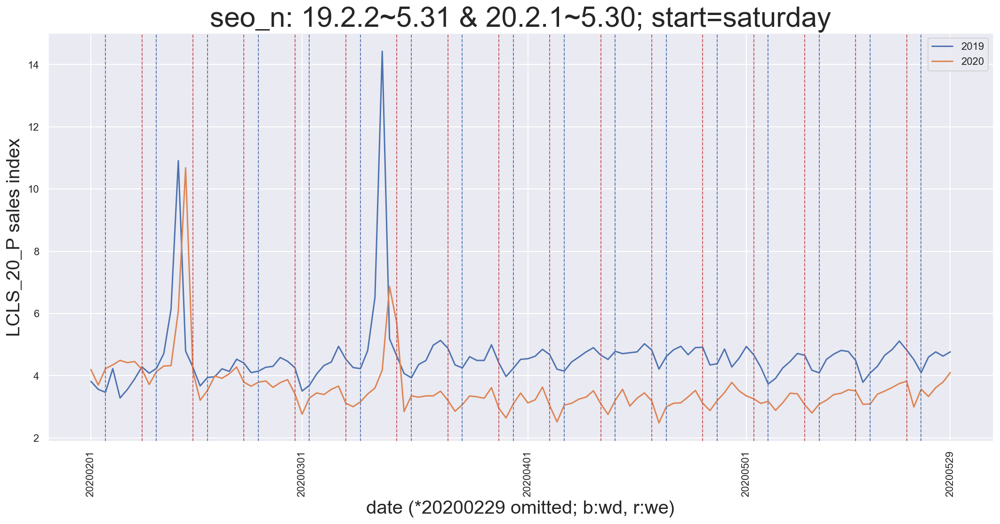

...

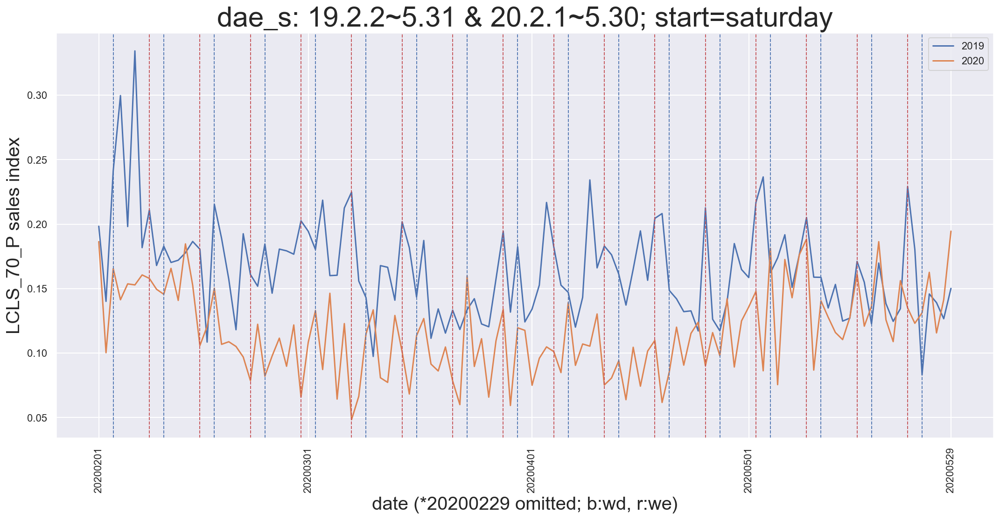

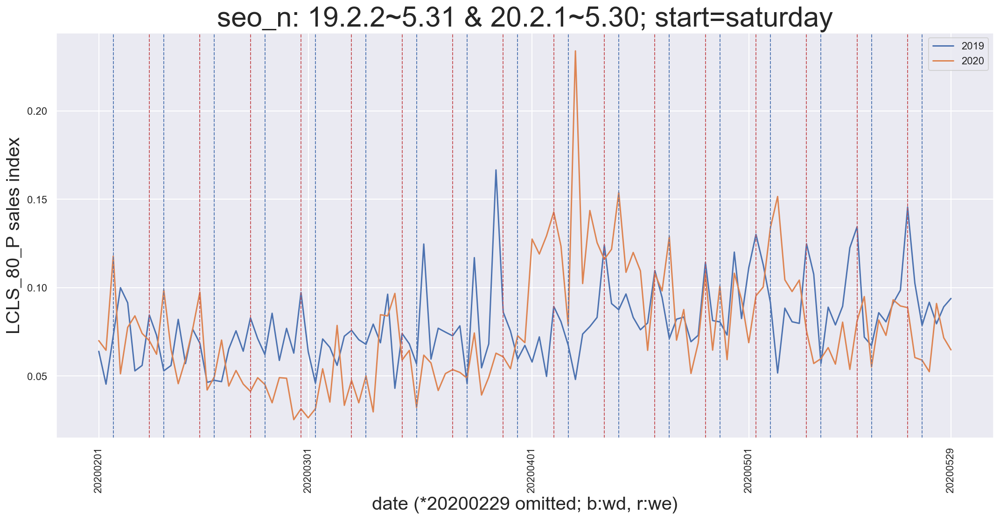

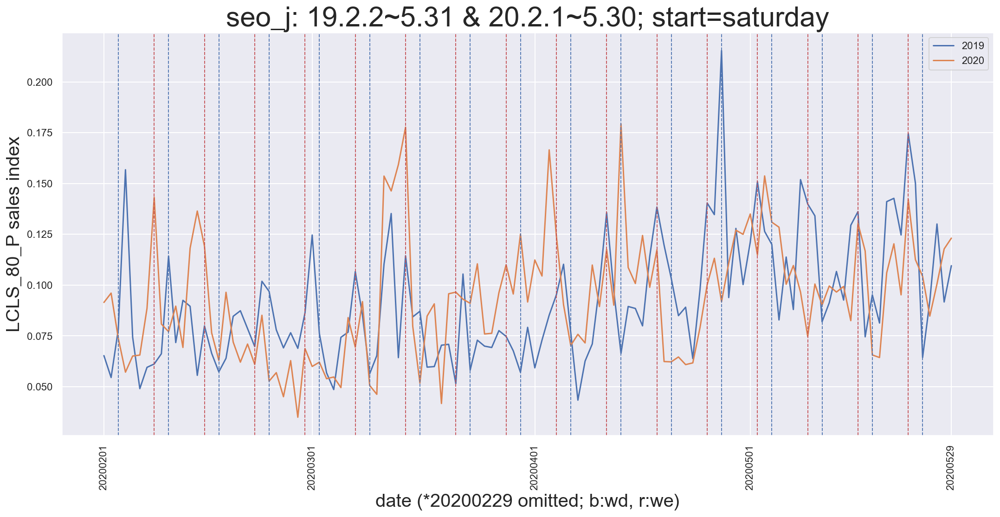

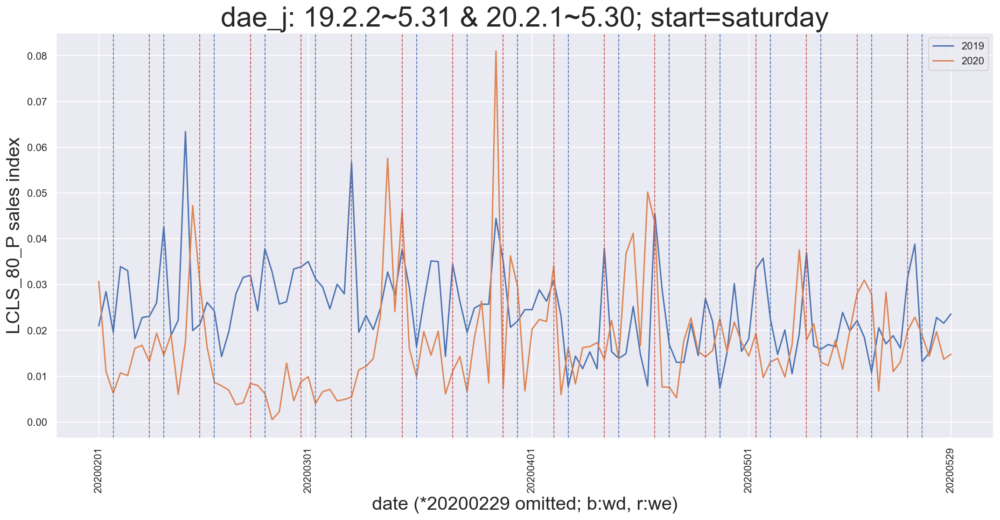

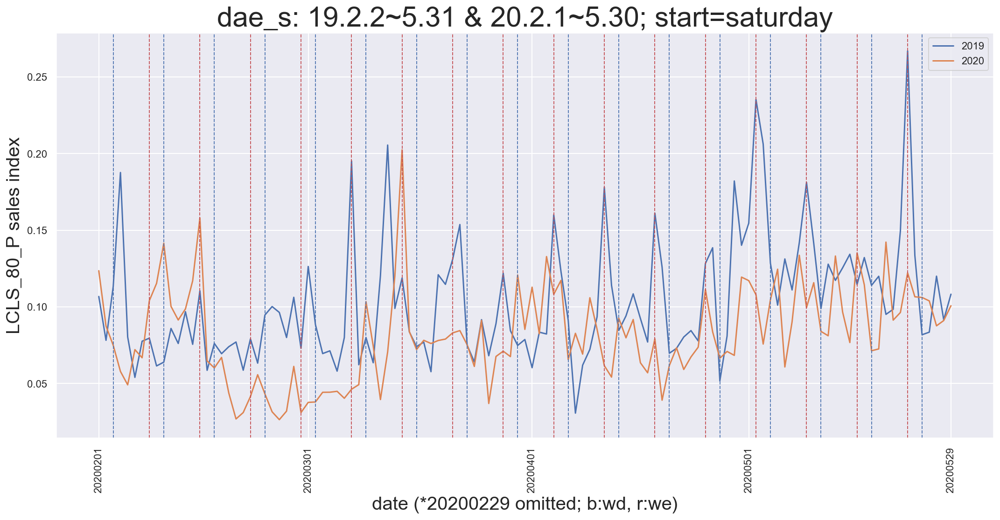

In [15]:
graph_category_sales_index(regions, df_19s, df_20s, categories)

In [33]:
[category + ' : mean' for category in categories]

['LCLS_10_P : mean',
 'LCLS_20_P : mean',
 'LCLS_30_P : mean',
 'LCLS_40_P : mean',
 'LCLS_50_P : mean',
 'LCLS_60_P : mean',
 'LCLS_70_P : mean',
 'LCLS_80_P : mean']

In [43]:
df_ = df.copy()

In [46]:
df_seo_j = df_[(df_["PVN"] == '서울특별시') & (df_["BOR"] == '중구')]
df_seo_n = df_[(df_["PVN"] == '서울특별시') & (df_["BOR"] == '노원구')]
df_dae_j = df_[(df_["PVN"] == '대구광역시') & (df_["BOR"] == '중구')]
df_dae_s = df_[(df_["PVN"] == '대구광역시') & (df_["BOR"] == '수성구')]

In [48]:
df_seo_j.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3615 entries, 45 to 14459
Data columns (total 13 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   OPER_DT    3615 non-null   object 
 1   PVN        3615 non-null   object 
 2   BOR        3615 non-null   object 
 3   ADMD       3615 non-null   object 
 4   AMT_IND    3615 non-null   float64
 5   LCLS_10_P  3615 non-null   float64
 6   LCLS_20_P  3615 non-null   float64
 7   LCLS_30_P  3615 non-null   float64
 8   LCLS_40_P  3615 non-null   float64
 9   LCLS_50_P  3615 non-null   float64
 10  LCLS_60_P  3615 non-null   float64
 11  LCLS_70_P  3615 non-null   float64
 12  LCLS_80_P  3615 non-null   float64
dtypes: float64(9), object(4)
memory usage: 395.4+ KB


In [66]:
regions = ['seo_n', 'seo_j', 'dae_j', 'dae_s']
df_s = [df_seo_j, df_seo_n, df_dae_j, df_dae_s]

def graph_every_category_sales_index(regions, df_s, categories):
    for region, df_ in zip(regions, df_s):
# setting region and category for graph
            
    # 구역별 도합 매출지수 
        aggregation_functions = {'AMT_IND': 'sum'}
        df_sum_amt = df_.groupby(df_['OPER_DT'], as_index=False).aggregate(aggregation_functions)

    # 구역별 평균 카테고리 유통비중 
        aggregation_function = {
            'LCLS_10_P' : 'mean',
            'LCLS_20_P' : 'mean',
            'LCLS_30_P' : 'mean',
            'LCLS_40_P' : 'mean',
            'LCLS_50_P' : 'mean',
            'LCLS_60_P' : 'mean',
            'LCLS_70_P' : 'mean',
            'LCLS_80_P' : 'mean'
        }
        LCLS_P = df_.groupby(df_['OPER_DT'], as_index=False).aggregate(aggregation_function)
        LCLS_ = pd.merge(left=df_sum_amt, right=LCLS_P, on="OPER_DT")

        
        plt.figure(figsize=(32,8))
        for category, categoryk in zip(categories, categories_kor):
            LCLS_[category] = LCLS_.AMT_IND * LCLS_[category]    
            x = LCLS_.OPER_DT
            y = LCLS_[category]
            plt.plot(x, y, label=categoryk)
    
  

        plt.grid(b=True, axis='y')
        plt.axvline(119.5, color='r', linestyle='--', linewidth=1)
        plt.legend()
        plt.xlabel('date (b:wd, r:we)', fontsize=20)
        plt.ylabel('sales index', fontsize=20)
        plt.xticks([0, 28, 59, 89, 119, 120, 149, 170, 200], rotation=90)
        plt.minorticks_on()
        plt.title(region + ': 19.2.1~5.31 & 20.2.1~5.31', fontsize=30)
        plt.show()


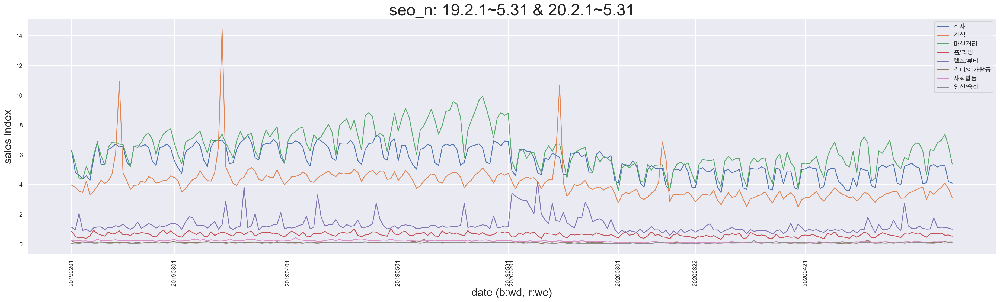

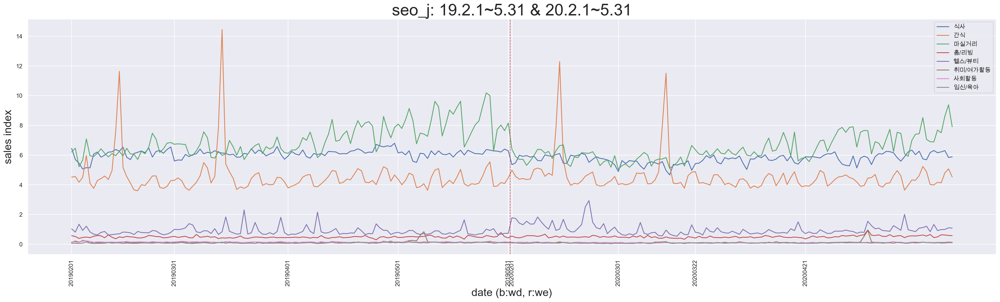

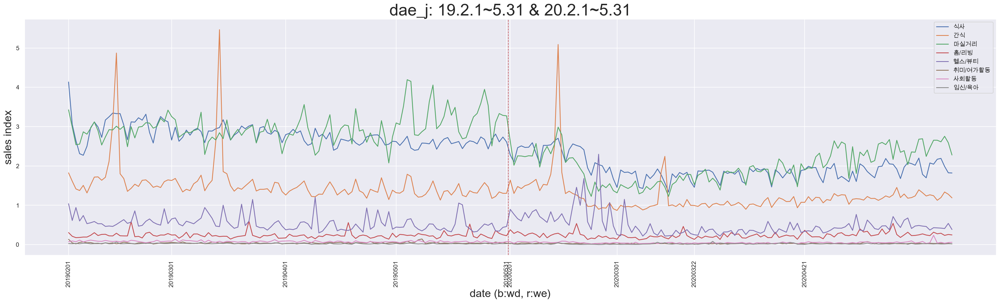

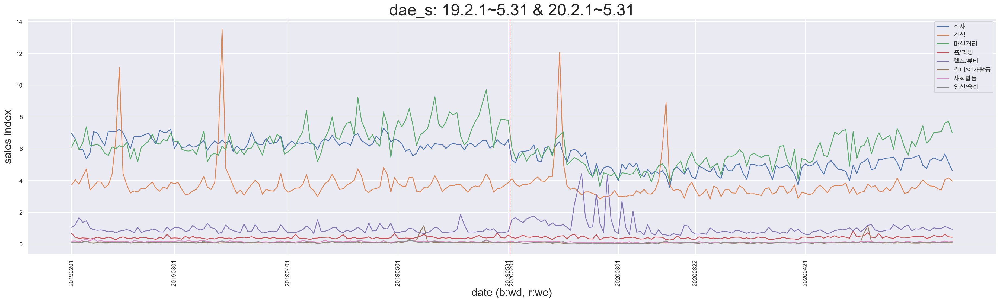

In [67]:
graph_every_category_sales_index(regions, df_s, categories)

In [110]:
regions = ['seo_n', 'seo_j', 'dae_j', 'dae_s']
df_s = [df_seo_j, df_seo_n, df_dae_j, df_dae_s]

def graph_category_sales_index_every_region(regions, df_s, categories):
    for category, categoryk in zip(categories, categories_kor):
# 구역별 평균 카테고리 유통비중 
        aggregation_function = {
            'LCLS_10_P' : 'mean',
            'LCLS_20_P' : 'mean',
            'LCLS_30_P' : 'mean',
            'LCLS_40_P' : 'mean',
            'LCLS_50_P' : 'mean',
            'LCLS_60_P' : 'mean',
            'LCLS_70_P' : 'mean',
            'LCLS_80_P' : 'mean'
        }
# 구역별 도합 매출지수 
        aggregation_functions = {'AMT_IND': 'sum'}
        
        plt.figure(figsize=(32,8))
        
        for region, df_ in zip(regions, df_s):
# setting region and category for graph
       
            df_sum_amt = df_.groupby(df_['OPER_DT'], as_index=False).aggregate(aggregation_functions)
            LCLS_P = df_.groupby(df_['OPER_DT'], as_index=False).aggregate(aggregation_function)
            LCLS_ = pd.merge(left=df_sum_amt, right=LCLS_P, on="OPER_DT")
            LCLS_[category] = LCLS_.AMT_IND * LCLS_[category]
    
            x = LCLS_.OPER_DT
            y = LCLS_[category]
            plt.plot(x, y, label=region)
    
  

        plt.grid(b=True, axis='y')
        plt.axvline(119.5, color='r', linestyle='--', linewidth=1)
        plt.legend()
        plt.xlabel('date (b:wd, r:we)', fontsize=20)
        plt.ylabel('sales index', fontsize=20)
        plt.ylim(0, 15)
        plt.xticks([0, 28, 59, 89, 119, 120, 149, 179, 209, 240], rotation=90)
        plt.minorticks_on()
        plt.title(categoryk + ': 19.2.1~5.31 & 20.2.1~5.31', fontsize=30)
        plt.show()


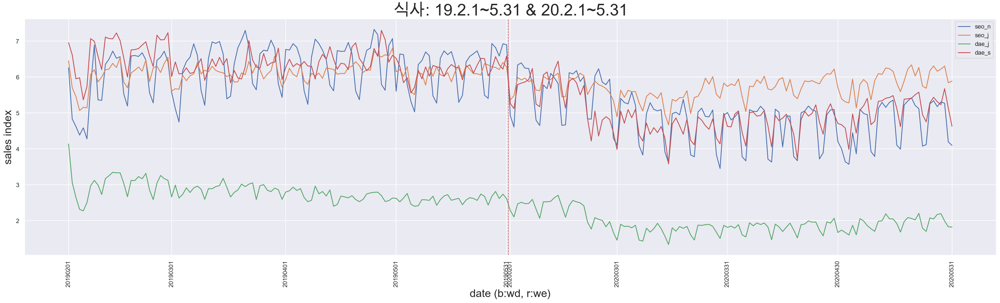

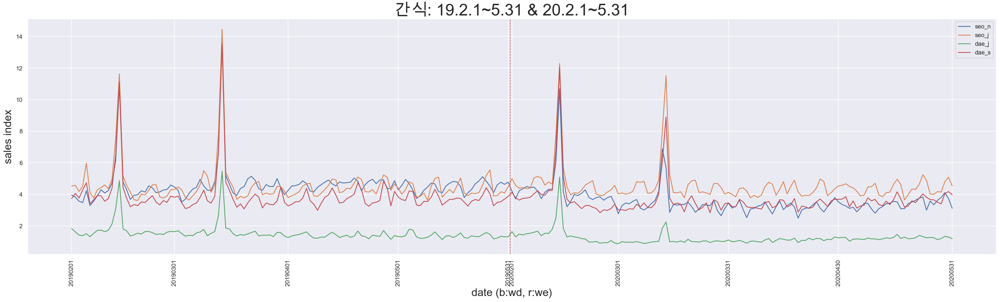

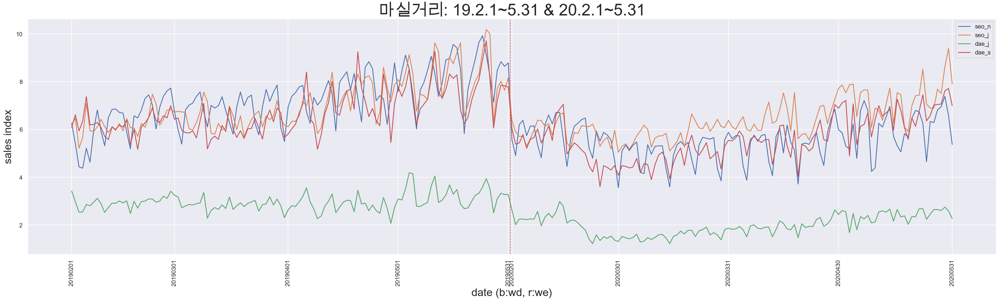

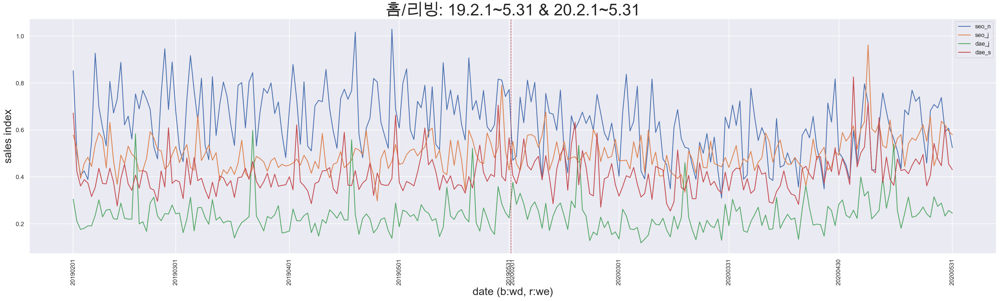

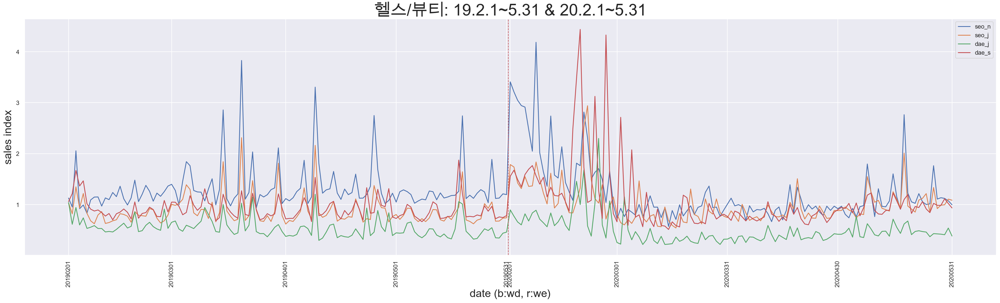

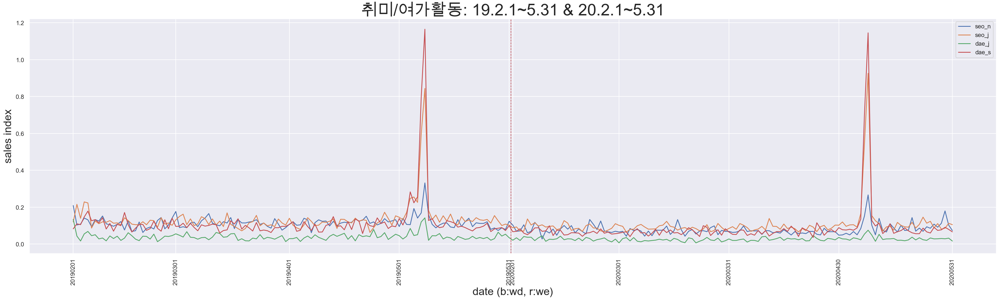

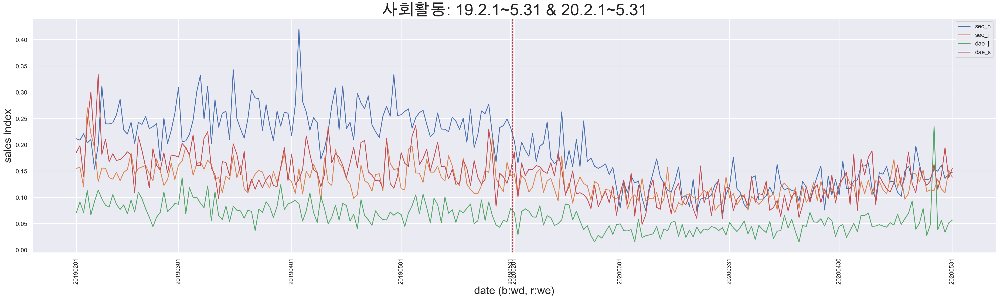

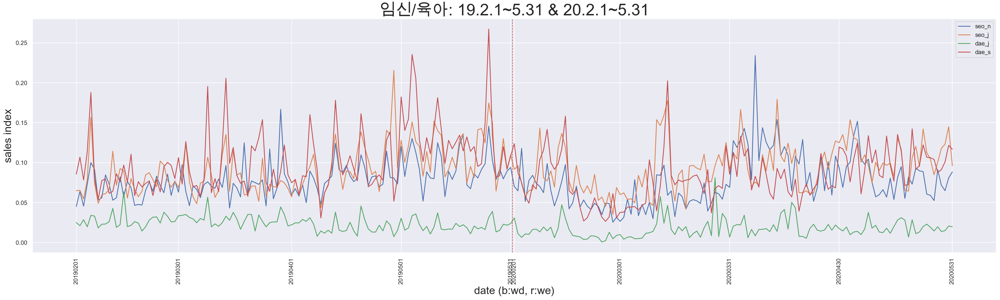

In [109]:
graph_category_sales_index_every_region(regions, df_s, categories)

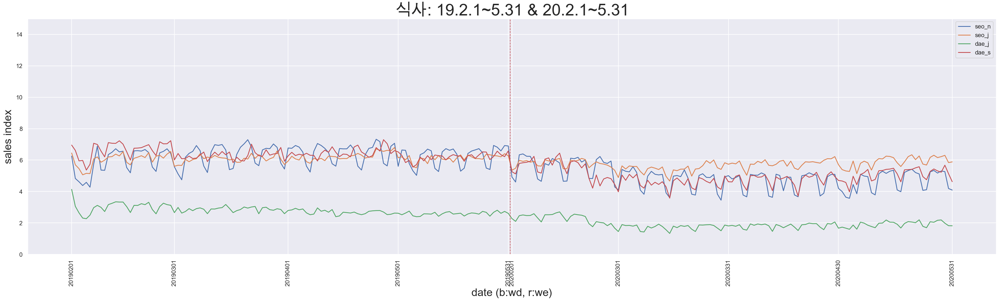

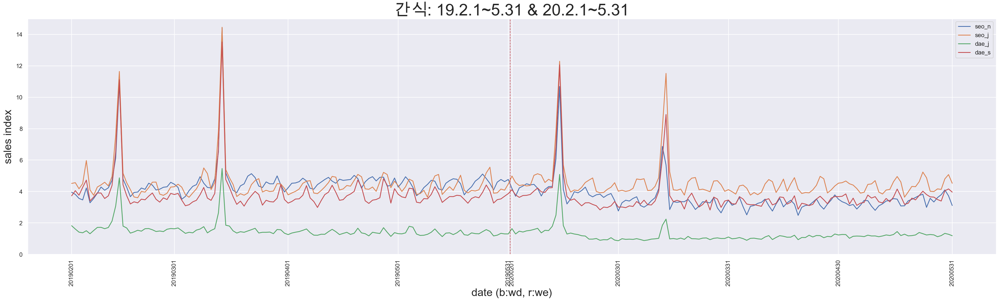

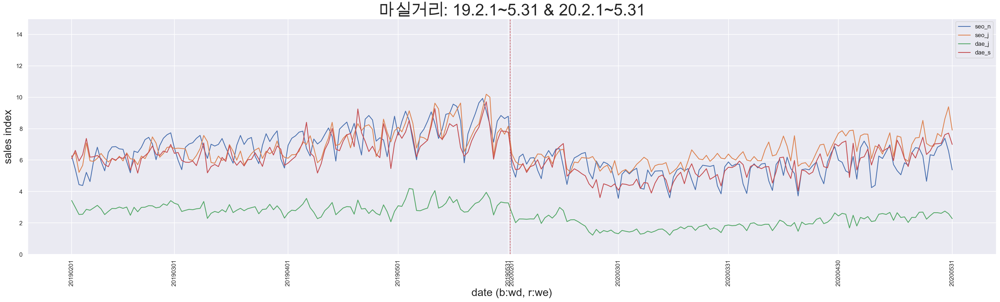

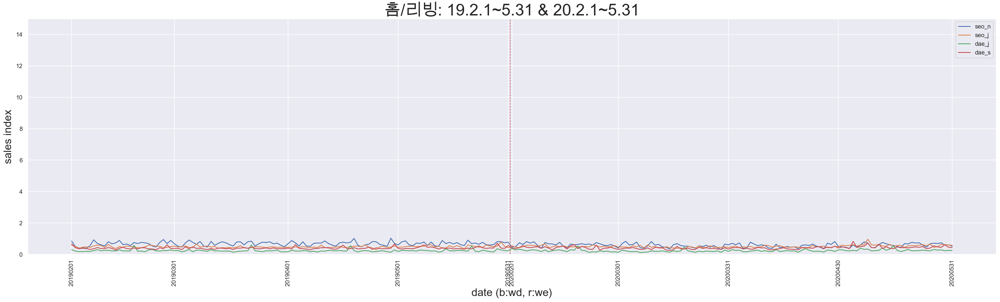

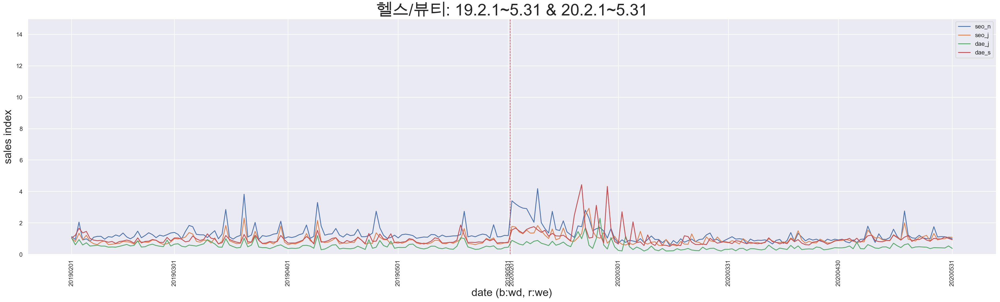

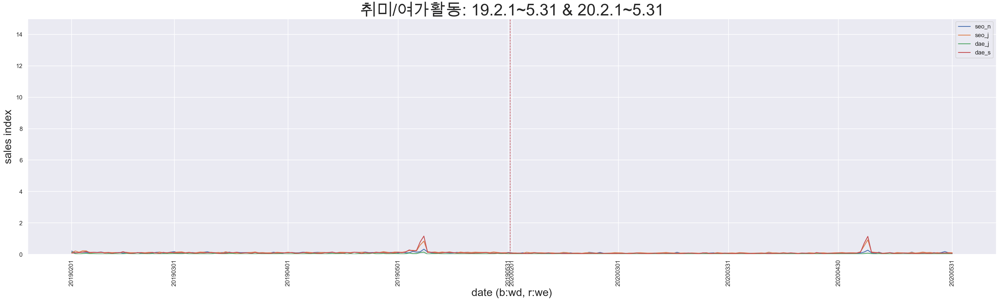

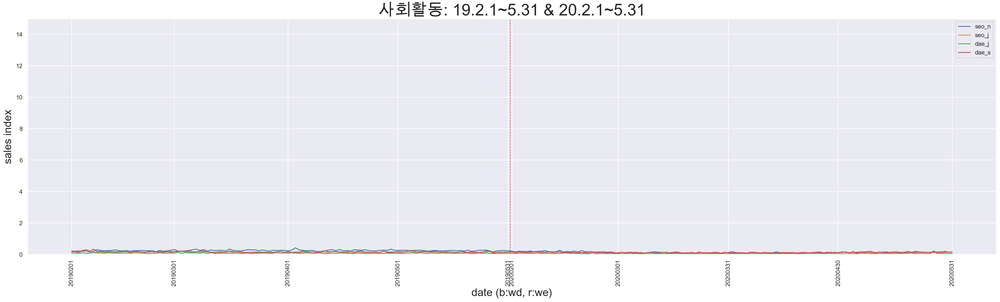

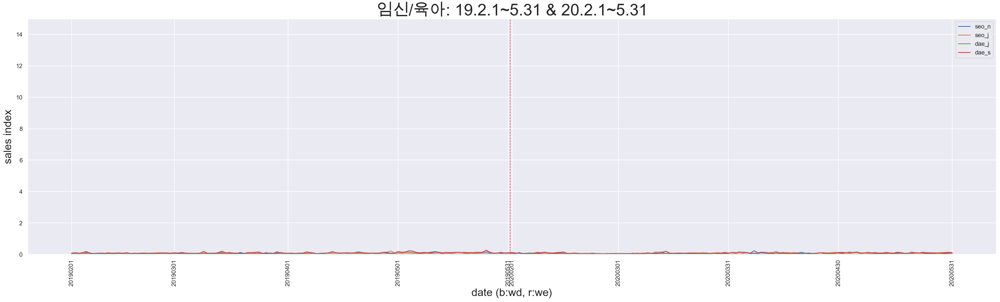

In [111]:
# plt.ylim(0,16) 수동설정 후 조금 더 객관적인 지표
graph_category_sales_index_every_region(regions, df_s, categories)